## Implementation of 
# Spectral-Spatial Hyperspectral Unmixing Using Multitask Learning
B. Palsson, J. R. Sveinsson and M. O. Ulfarsson, "Spectral-Spatial Hyperspectral Unmixing Using Multitask Learning," in IEEE Access, vol. 7, pp. 148861-148872, 2019, doi: 10.1109/ACCESS.2019.2944072.

### Imports

In [1]:
import tensorflow as tf
from tensorflow.keras import initializers, constraints, layers, activations, regularizers
from tensorflow.python.ops import math_ops
from tensorflow.python.keras import backend as K
from tensorflow.python.framework import tensor_shape
from unmixing import HSI, plotEndmembers,SAD
from unmixing import plotEndmembersAndGT, plotAbundancesSimple, load_HSI, PlotWhileTraining
from sklearn.feature_extraction.image import extract_patches_2d
from scipy import io as sio
import os
import numpy as np
from numpy.linalg import inv
import warnings
import matplotlib
import matplotlib.pyplot as plt
#%warnings.filterwarnings("ignore")
%matplotlib inline

### Use CPU

In [2]:
os.environ["CUDA_VISIBLE_DEVICES"] = "-1"

## Class SumToOne
Also performs regularizations l1 and OSP 
$$L_\text{OSP}+\rho_2\sum_i L_1(\bf{h_i})$$

In [3]:
class SumToOne(layers.Layer):
    def __init__(self, params, **kwargs):
        super(SumToOne, self).__init__(**kwargs)
        self.num_outputs = params['num_endmembers']
        self.params = params
        
    def l1_regularization(self,x):
        l1 = tf.reduce_sum(tf.abs(x))
        return self.params['l1'] * l1
    
    def osp_regularization(self,x):
        return self.params['osp']*OSP(x,self.params['num_endmembers'])
        
    def call(self, x):
        self.add_loss(self.l1_regularization(x))
        x = tf.nn.softmax(self.params['scale'] * x)
        return x

## Class Autoencoder
Wrapper class for the autoencoder model and associcated utility functions

In [4]:
class Autoencoder(object):
    def __init__(self, params):
        self.data = None
        self.params = params
        self.model = self.create_model()
        self.model.compile(optimizer=self.params["optimizer"], loss=self.params["loss"])
    
        
    def create_model(self):
        input_ = []
        output = []
        #init = initializers.glorot_normal()
        init = initializers.RandomNormal(0.01, 0.1)
        init2 = initializers.RandomNormal(0.01, 0.1)
        for i in range(n_inputs):
            input_.append(layers.Input(shape=(self.params['n_bands'],), name='input' + str(i)))
        concatenated = layers.concatenate([input_[i] for i in range(n_inputs)])
        concatenated = layers.GaussianNoise(0.05)(concatenated)
        
        dense = layers.Dense(units=(self.params['n_bands'] * self.params['n_inputs']) // 4,
                      name='dense1',
                      activation=self.params['activation'],
                      use_bias=False,
                      kernel_initializer=init)(concatenated)
        dense = layers.Dropout(0.5)(dense)
        dense = layers.BatchNormalization()(dense)
        endmembers = layers.Dense(units=self.params['n_bands'],
                           activation='linear',
                           name='endmembers',
                           use_bias=False,
                           kernel_constraint=constraints.non_neg(),
                           kernel_initializer=init)
        for i in range(n_inputs):
            abund = layers.Dense(units=self.params['num_endmembers'],
                          name='dense_3' + str(i),
                          activation=self.params['activation'],
                          use_bias=False,
                          kernel_initializer=init)(dense)
            abund = layers.BatchNormalization()(abund)
            abund = layers.Dropout(0.1)(abund)
            abund = SumToOne(self.params, name='abundances' + str(i))(abund)
            output.append(endmembers(abund))

        return tf.keras.Model(inputs=[input_[i] for i in range(n_inputs)], outputs=[output[i] for i in range(n_inputs)])
    
    def fit(self,data):
        self.data = data
        num_inputs = self.params['n_inputs']
        return self.model.fit(
            [self.data[:, i, :] for i in range(num_inputs)],
            [self.data[:, i, :] for i in range(num_inputs)],
            batch_size=self.params["batch_size"],
            epochs=self.params["epochs"],
            verbose=1
        )
    

    def get_endmembers(self):
        return self.model.layers[len(self.model.layers) - 1].get_weights()[0]

    def get_abundances(self):
        intermediate_layer_model = tf.keras.Model(inputs=self.model.input,
                                         outputs=[self.model.get_layer('abundances' + str(i)).output for i in
                                                  range(self.params['n_inputs'])])
        abundances = np.mean(intermediate_layer_model.predict([self.params['data'].array() for i in range(self.params['n_inputs'])]),
                             axis=0)
        abundances = np.reshape(abundances,[self.params['data'].cols,self.params['data'].rows,self.params['num_endmembers']])
        return abundances
    

## Method make_patches
Makes $n\times n$ patches for MTL unmixer

In [8]:
def make_patches(hsi, n, num_patches):
    patch_size = n
    data = extract_patches_2d(hsi.image, patch_size=(n, n), max_patches=num_patches)
    s = data.shape
    data = data.reshape(s[0], n * n, hsi.bands)
    return data

## Load Data and set Hyperparameters

In [11]:
#Dictonary of aliases for datasets. The first string is the key and second is value (name of matfile without .mat suffix)
#Useful when looping over datasets
datasetnames = {
        "Urban": "Urban4",
}

dataset = "Urban"

hsi = load_HSI(
    datasetnames[dataset] + ".mat"
)

# Hyperparameters
num_endmembers = 4
n_inputs = 4
num_patches = 2000
batch_size = 15
learning_rate = 0.001
epochs = 60
loss = SAD
activation = layers.LeakyReLU(0.2)
l1 = 0

# Hyperparameter dictionary
params = {
    'n_inputs':n_inputs,
    "activation": activation,
    "num_endmembers": num_endmembers,
    "batch_size": batch_size,
    "num_patches": num_patches,
    #"data": hsi,
    "epochs": epochs,
    "n_bands": hsi.bands,
    #"GT": hsi.gt,
    "lr": learning_rate,
    "optimizer": tf.optimizers.RMSprop(learning_rate=learning_rate,decay=0.000),
    "loss": loss,
    "scale": 3,
    "l1": l1,
}

training_data = make_patches(hsi,params['n_inputs'],params['num_patches'])


## Train Autoencoder

In [15]:
autoencoder = Autoencoder(params)
autoencoder.fit(training_data)
endmembers = autoencoder.get_endmembers()
abundances = autoencoder.get_abundances()
#plotEndmembersAndGT(endmembers, hsi.gt)
plotAbundancesSimple(abundances,'abund.png')

Epoch 1/60
134/134 [==============================] - 3s 3ms/step - loss: 6.2619 - endmembers_loss: 1.5655 - endmembers_1_loss: 1.5654 - endmembers_2_loss: 1.5655 - endmembers_3_loss: 1.5655
Epoch 2/60
134/134 [==============================] - 0s 3ms/step - loss: 6.2591 - endmembers_loss: 1.5648 - endmembers_1_loss: 1.5648 - endmembers_2_loss: 1.5648 - endmembers_3_loss: 1.5648
Epoch 3/60
134/134 [==============================] - 0s 3ms/step - loss: 6.2590 - endmembers_loss: 1.5647 - endmembers_1_loss: 1.5647 - endmembers_2_loss: 1.5647 - endmembers_3_loss: 1.5648
Epoch 4/60
134/134 [==============================] - 0s 3ms/step - loss: 6.2589 - endmembers_loss: 1.5647 - endmembers_1_loss: 1.5647 - endmembers_2_loss: 1.5647 - endmembers_3_loss: 1.5647
Epoch 5/60
134/134 [==============================] - 0s 3ms/step - loss: 6.2589 - endmembers_loss: 1.5647 - endmembers_1_loss: 1.5647 - endmembers_2_loss: 1.5647 - endmembers_3_loss: 1.5647
Epoch 6/60
134/134 [=========================

KeyError: 'data'

## Run experiment 

run nr: 1

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2778 - endmembers_loss: 1.5690 - endmembers_1_loss: 1.5698 - endmembers_2_loss: 1.5695 - endmembers_3_loss: 1.5695
Epoch 2/60
1/1 [==============================] - 0s 7ms/step - loss: 6.2678 - endmembers_loss: 1.5668 - endmembers_1_loss: 1.5668 - endmembers_2_loss: 1.5668 - endmembers_3_loss: 1.5674
Epoch 3/60
1/1 [==============================] - 0s 6ms/step - loss: 6.2666 - endmembers_loss: 1.5664 - endmembers_1_loss: 1.5667 - endmembers_2_loss: 1.5665 - endmembers_3_loss: 1.5670
Epoch 4/60
1/1 [==============================] - 0s 5ms/step - loss: 6.2673 - endmembers_loss: 1.5668 - endmembers_1_loss: 1.5668 - endmembers_2_loss: 1.5668 - endmembers_3_loss: 1.5669
Epoch 5/60
1/1 [==============================] - 0s 12ms/step - loss: 6.2666 - endmembers_loss: 1.5664 - endmembers_1_loss: 1.5668 - endmembers_2_loss: 1.5665 - endmembers_3_loss: 1.5669
Epoch 6/60
1/1 [==============================] - 0s 0

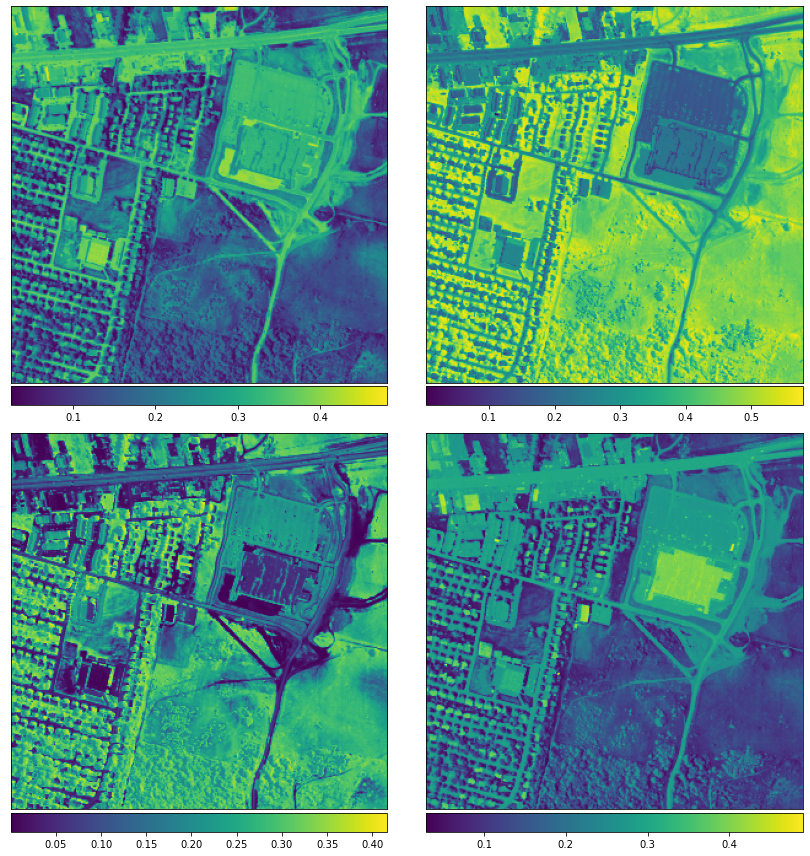

run nr: 2

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2776 - endmembers_loss: 1.5692 - endmembers_1_loss: 1.5693 - endmembers_2_loss: 1.5696 - endmembers_3_loss: 1.5696
Epoch 2/60
1/1 [==============================] - 0s 0s/step - loss: 6.2680 - endmembers_loss: 1.5668 - endmembers_1_loss: 1.5675 - endmembers_2_loss: 1.5671 - endmembers_3_loss: 1.5667
Epoch 3/60
1/1 [==============================] - 0s 0s/step - loss: 6.2679 - endmembers_loss: 1.5667 - endmembers_1_loss: 1.5669 - endmembers_2_loss: 1.5672 - endmembers_3_loss: 1.5672
Epoch 4/60
1/1 [==============================] - 0s 0s/step - loss: 6.2679 - endmembers_loss: 1.5672 - endmembers_1_loss: 1.5672 - endmembers_2_loss: 1.5670 - endmembers_3_loss: 1.5665
Epoch 5/60
1/1 [==============================] - 0s 8ms/step - loss: 6.2675 - endmembers_loss: 1.5671 - endmembers_1_loss: 1.5670 - endmembers_2_loss: 1.5665 - endmembers_3_loss: 1.5670
Epoch 6/60
1/1 [==============================] - 0s 9ms/s

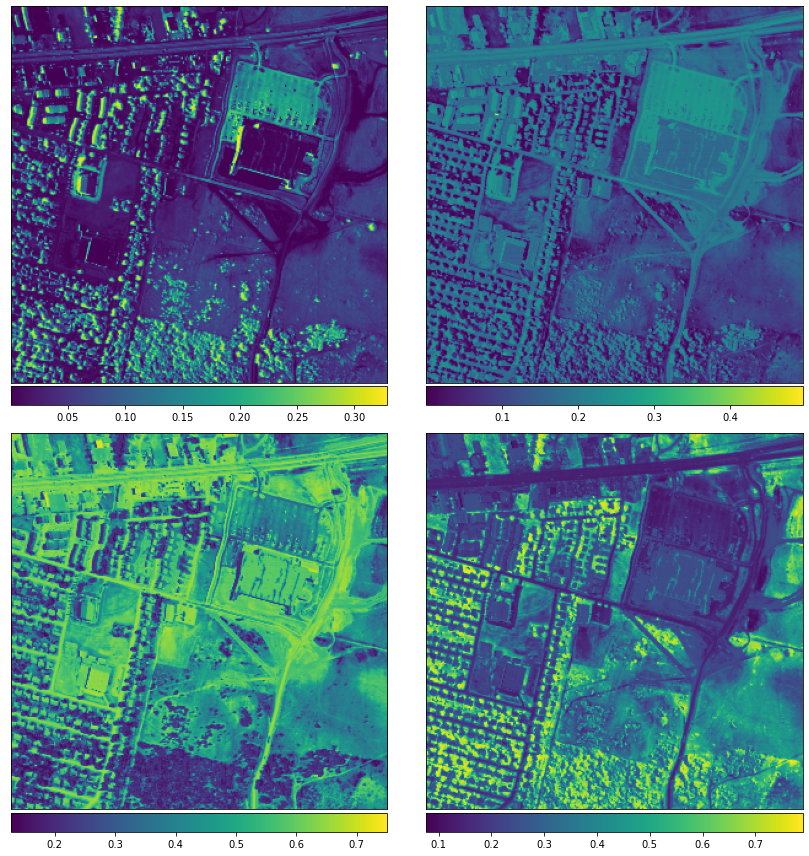

run nr: 3

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2812 - endmembers_loss: 1.5705 - endmembers_1_loss: 1.5701 - endmembers_2_loss: 1.5701 - endmembers_3_loss: 1.5705
Epoch 2/60
1/1 [==============================] - 0s 6ms/step - loss: 6.2695 - endmembers_loss: 1.5679 - endmembers_1_loss: 1.5674 - endmembers_2_loss: 1.5673 - endmembers_3_loss: 1.5669
Epoch 3/60
1/1 [==============================] - 0s 12ms/step - loss: 6.2685 - endmembers_loss: 1.5673 - endmembers_1_loss: 1.5671 - endmembers_2_loss: 1.5671 - endmembers_3_loss: 1.5670
Epoch 4/60
1/1 [==============================] - 0s 0s/step - loss: 6.2689 - endmembers_loss: 1.5673 - endmembers_1_loss: 1.5673 - endmembers_2_loss: 1.5674 - endmembers_3_loss: 1.5668
Epoch 5/60
1/1 [==============================] - 0s 3ms/step - loss: 6.2679 - endmembers_loss: 1.5671 - endmembers_1_loss: 1.5671 - endmembers_2_loss: 1.5667 - endmembers_3_loss: 1.5670
Epoch 6/60
1/1 [==============================] - 0s 9m

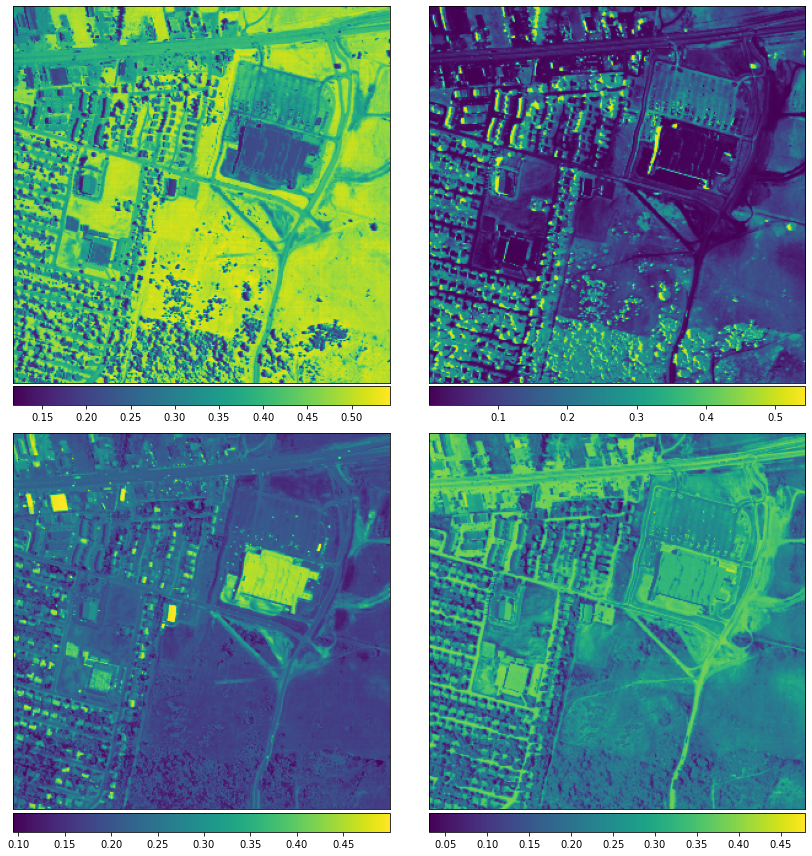

run nr: 4

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2813 - endmembers_loss: 1.5706 - endmembers_1_loss: 1.5701 - endmembers_2_loss: 1.5704 - endmembers_3_loss: 1.5702
Epoch 2/60
1/1 [==============================] - 0s 10ms/step - loss: 6.2686 - endmembers_loss: 1.5672 - endmembers_1_loss: 1.5668 - endmembers_2_loss: 1.5670 - endmembers_3_loss: 1.5676
Epoch 3/60
1/1 [==============================] - 0s 10ms/step - loss: 6.2686 - endmembers_loss: 1.5674 - endmembers_1_loss: 1.5673 - endmembers_2_loss: 1.5669 - endmembers_3_loss: 1.5670
Epoch 4/60
1/1 [==============================] - 0s 14ms/step - loss: 6.2680 - endmembers_loss: 1.5671 - endmembers_1_loss: 1.5670 - endmembers_2_loss: 1.5670 - endmembers_3_loss: 1.5669
Epoch 5/60
1/1 [==============================] - 0s 16ms/step - loss: 6.2678 - endmembers_loss: 1.5672 - endmembers_1_loss: 1.5670 - endmembers_2_loss: 1.5668 - endmembers_3_loss: 1.5668
Epoch 6/60
1/1 [==============================] - 0

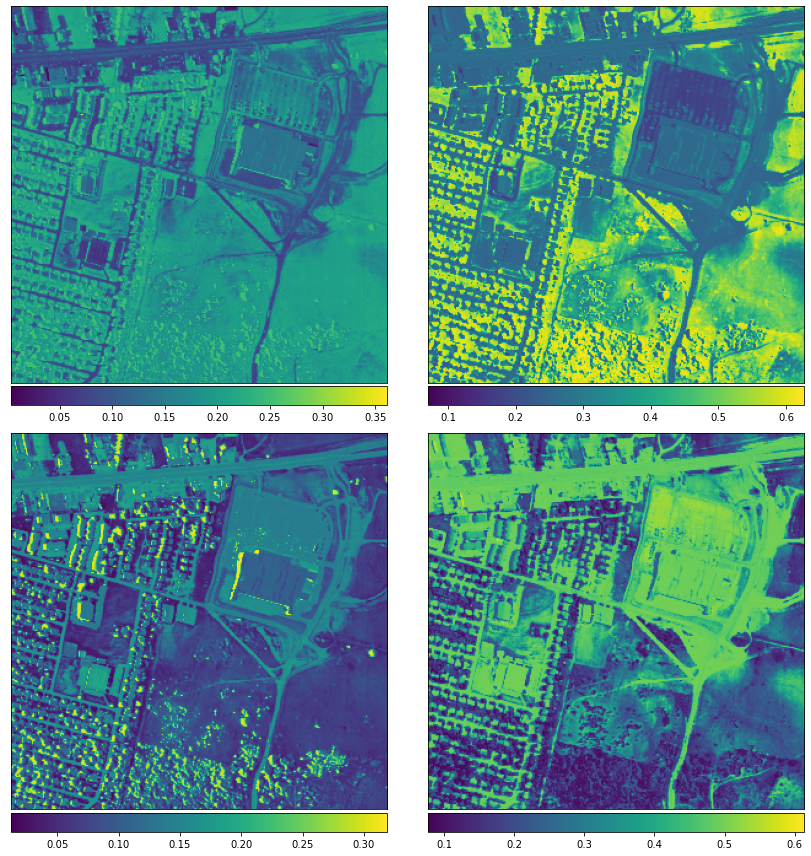

run nr: 5

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2797 - endmembers_loss: 1.5698 - endmembers_1_loss: 1.5699 - endmembers_2_loss: 1.5700 - endmembers_3_loss: 1.5700
Epoch 2/60
1/1 [==============================] - 0s 0s/step - loss: 6.2691 - endmembers_loss: 1.5675 - endmembers_1_loss: 1.5675 - endmembers_2_loss: 1.5671 - endmembers_3_loss: 1.5670
Epoch 3/60
1/1 [==============================] - 0s 0s/step - loss: 6.2680 - endmembers_loss: 1.5667 - endmembers_1_loss: 1.5669 - endmembers_2_loss: 1.5672 - endmembers_3_loss: 1.5671
Epoch 4/60
1/1 [==============================] - 0s 0s/step - loss: 6.2681 - endmembers_loss: 1.5669 - endmembers_1_loss: 1.5673 - endmembers_2_loss: 1.5670 - endmembers_3_loss: 1.5669
Epoch 5/60
1/1 [==============================] - 0s 0s/step - loss: 6.2671 - endmembers_loss: 1.5667 - endmembers_1_loss: 1.5669 - endmembers_2_loss: 1.5667 - endmembers_3_loss: 1.5668
Epoch 6/60
1/1 [==============================] - 0s 0s/ste

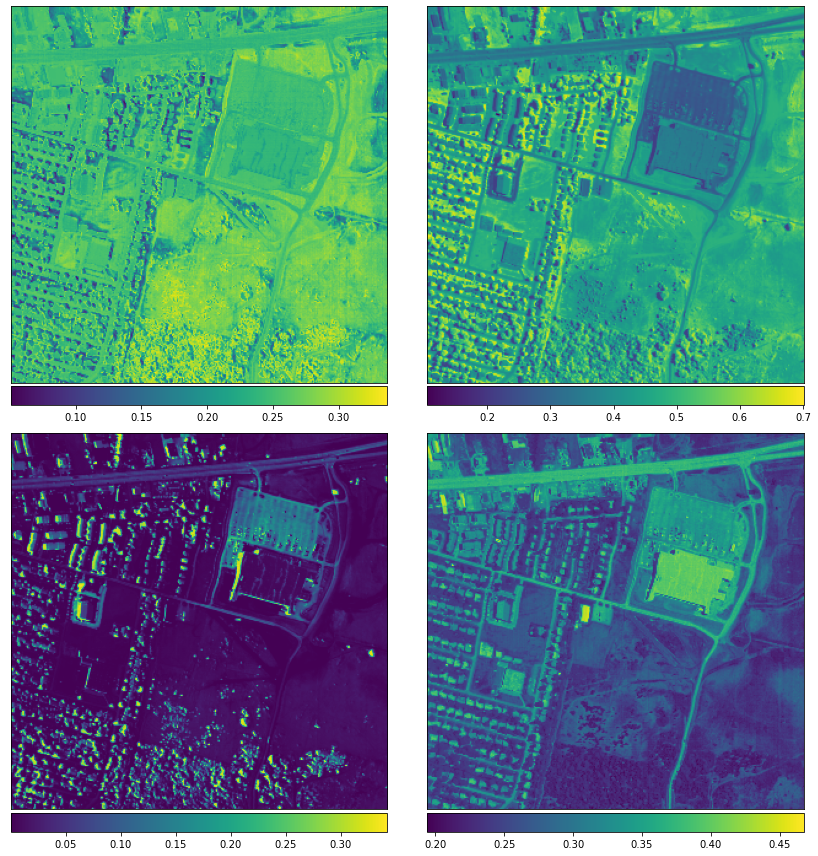

run nr: 6

Epoch 1/60
1/1 [==============================] - 2s 2s/step - loss: 6.2828 - endmembers_loss: 1.5708 - endmembers_1_loss: 1.5706 - endmembers_2_loss: 1.5706 - endmembers_3_loss: 1.5708
Epoch 2/60
1/1 [==============================] - 0s 16ms/step - loss: 6.2689 - endmembers_loss: 1.5674 - endmembers_1_loss: 1.5672 - endmembers_2_loss: 1.5671 - endmembers_3_loss: 1.5672
Epoch 3/60
1/1 [==============================] - 0s 0s/step - loss: 6.2677 - endmembers_loss: 1.5664 - endmembers_1_loss: 1.5667 - endmembers_2_loss: 1.5673 - endmembers_3_loss: 1.5672
Epoch 4/60
1/1 [==============================] - 0s 0s/step - loss: 6.2676 - endmembers_loss: 1.5668 - endmembers_1_loss: 1.5669 - endmembers_2_loss: 1.5671 - endmembers_3_loss: 1.5667
Epoch 5/60
1/1 [==============================] - 0s 0s/step - loss: 6.2670 - endmembers_loss: 1.5667 - endmembers_1_loss: 1.5667 - endmembers_2_loss: 1.5668 - endmembers_3_loss: 1.5668
Epoch 6/60
1/1 [==============================] - 0s 0s/s

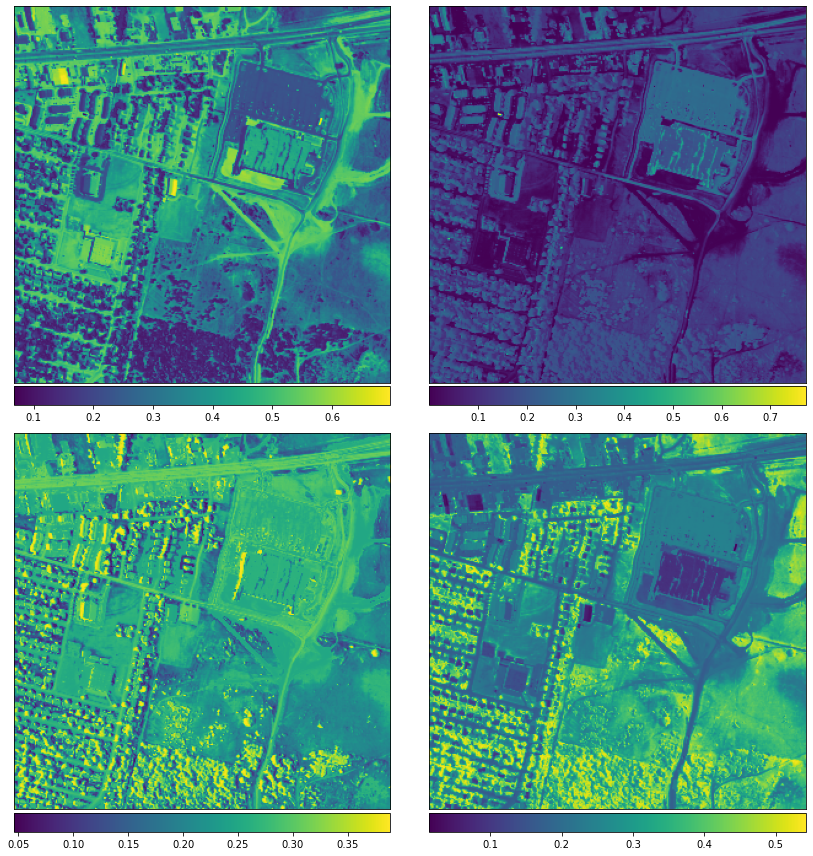

run nr: 7

Epoch 1/60
1/1 [==============================] - 2s 2s/step - loss: 6.2810 - endmembers_loss: 1.5701 - endmembers_1_loss: 1.5701 - endmembers_2_loss: 1.5705 - endmembers_3_loss: 1.5703
Epoch 2/60
1/1 [==============================] - 0s 0s/step - loss: 6.2676 - endmembers_loss: 1.5673 - endmembers_1_loss: 1.5669 - endmembers_2_loss: 1.5664 - endmembers_3_loss: 1.5670
Epoch 3/60
1/1 [==============================] - 0s 16ms/step - loss: 6.2664 - endmembers_loss: 1.5666 - endmembers_1_loss: 1.5666 - endmembers_2_loss: 1.5668 - endmembers_3_loss: 1.5664
Epoch 4/60
1/1 [==============================] - 0s 16ms/step - loss: 6.2664 - endmembers_loss: 1.5668 - endmembers_1_loss: 1.5665 - endmembers_2_loss: 1.5662 - endmembers_3_loss: 1.5669
Epoch 5/60
1/1 [==============================] - 0s 0s/step - loss: 6.2655 - endmembers_loss: 1.5664 - endmembers_1_loss: 1.5665 - endmembers_2_loss: 1.5662 - endmembers_3_loss: 1.5664
Epoch 6/60
1/1 [==============================] - 0s 0s

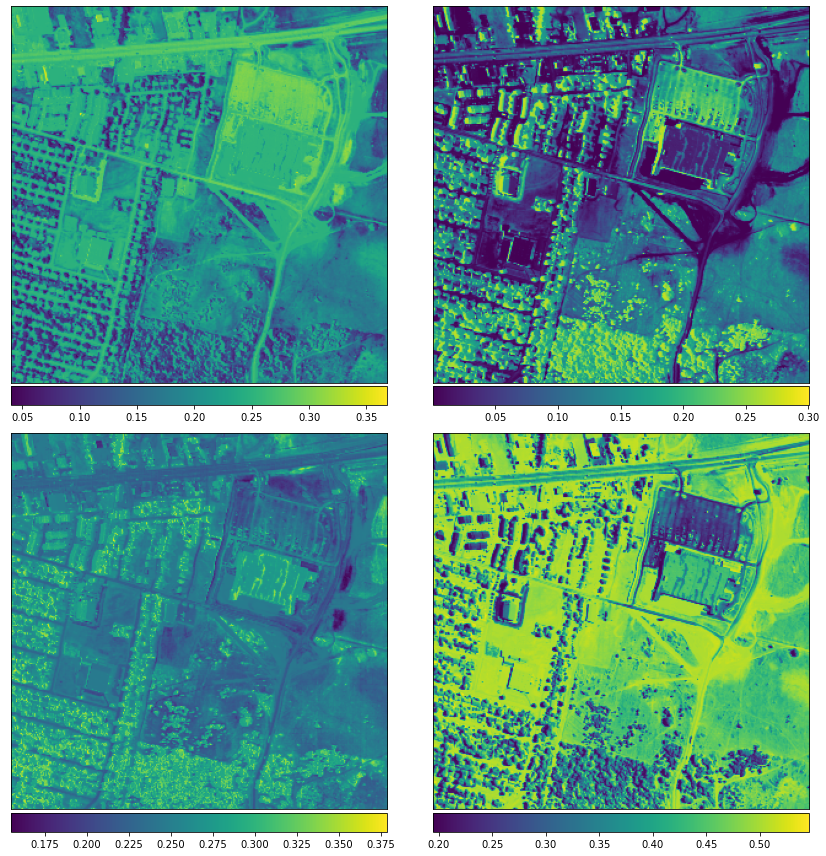

run nr: 8

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2793 - endmembers_loss: 1.5700 - endmembers_1_loss: 1.5699 - endmembers_2_loss: 1.5699 - endmembers_3_loss: 1.5695
Epoch 2/60
1/1 [==============================] - 0s 0s/step - loss: 6.2676 - endmembers_loss: 1.5665 - endmembers_1_loss: 1.5669 - endmembers_2_loss: 1.5671 - endmembers_3_loss: 1.5671
Epoch 3/60
1/1 [==============================] - 0s 15ms/step - loss: 6.2687 - endmembers_loss: 1.5672 - endmembers_1_loss: 1.5672 - endmembers_2_loss: 1.5670 - endmembers_3_loss: 1.5673
Epoch 4/60
1/1 [==============================] - 0s 0s/step - loss: 6.2680 - endmembers_loss: 1.5670 - endmembers_1_loss: 1.5671 - endmembers_2_loss: 1.5668 - endmembers_3_loss: 1.5672
Epoch 5/60
1/1 [==============================] - 0s 4ms/step - loss: 6.2672 - endmembers_loss: 1.5670 - endmembers_1_loss: 1.5669 - endmembers_2_loss: 1.5668 - endmembers_3_loss: 1.5665
Epoch 6/60
1/1 [==============================] - 0s 13m

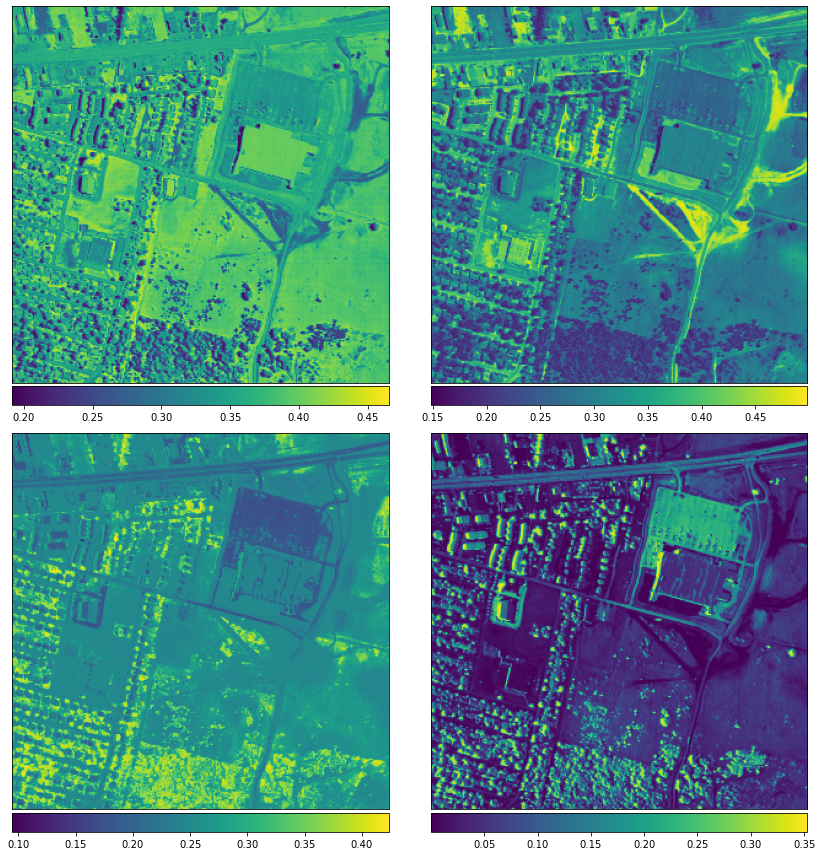

run nr: 9

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2806 - endmembers_loss: 1.5701 - endmembers_1_loss: 1.5702 - endmembers_2_loss: 1.5700 - endmembers_3_loss: 1.5702
Epoch 2/60
1/1 [==============================] - 0s 0s/step - loss: 6.2679 - endmembers_loss: 1.5673 - endmembers_1_loss: 1.5669 - endmembers_2_loss: 1.5666 - endmembers_3_loss: 1.5671
Epoch 3/60
1/1 [==============================] - 0s 16ms/step - loss: 6.2680 - endmembers_loss: 1.5670 - endmembers_1_loss: 1.5672 - endmembers_2_loss: 1.5668 - endmembers_3_loss: 1.5670
Epoch 4/60
1/1 [==============================] - 0s 10ms/step - loss: 6.2680 - endmembers_loss: 1.5671 - endmembers_1_loss: 1.5668 - endmembers_2_loss: 1.5667 - endmembers_3_loss: 1.5674
Epoch 5/60
1/1 [==============================] - 0s 0s/step - loss: 6.2678 - endmembers_loss: 1.5667 - endmembers_1_loss: 1.5671 - endmembers_2_loss: 1.5671 - endmembers_3_loss: 1.5669
Epoch 6/60
1/1 [==============================] - 0s 0s

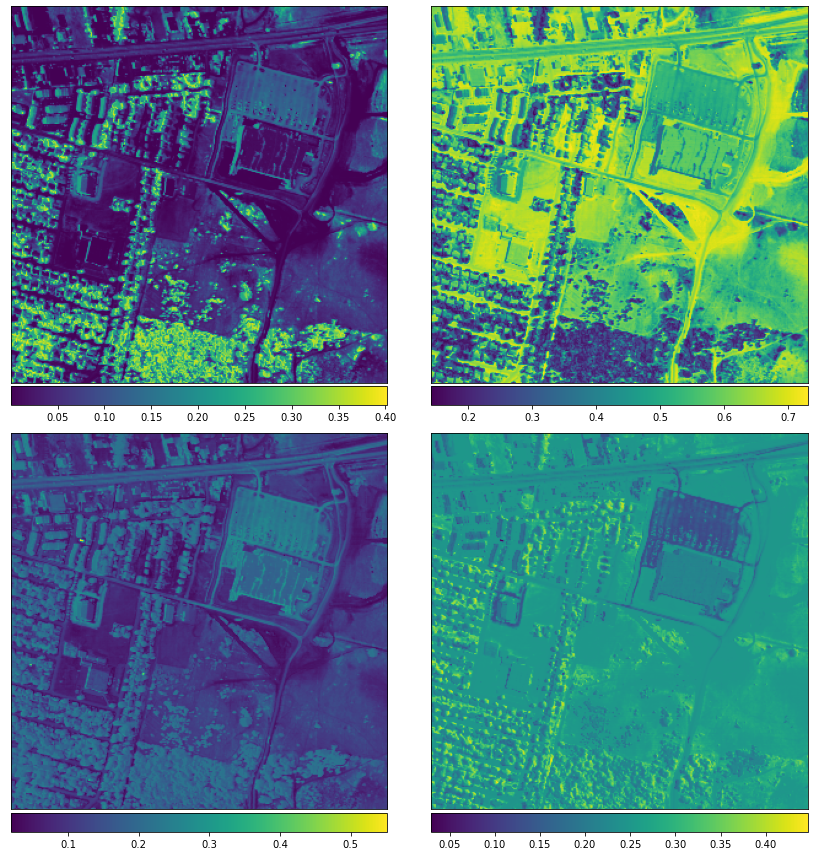

run nr: 10

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2817 - endmembers_loss: 1.5703 - endmembers_1_loss: 1.5703 - endmembers_2_loss: 1.5704 - endmembers_3_loss: 1.5706
Epoch 2/60
1/1 [==============================] - 0s 0s/step - loss: 6.2680 - endmembers_loss: 1.5668 - endmembers_1_loss: 1.5669 - endmembers_2_loss: 1.5671 - endmembers_3_loss: 1.5672
Epoch 3/60
1/1 [==============================] - 0s 0s/step - loss: 6.2677 - endmembers_loss: 1.5668 - endmembers_1_loss: 1.5667 - endmembers_2_loss: 1.5670 - endmembers_3_loss: 1.5671
Epoch 4/60
1/1 [==============================] - 0s 16ms/step - loss: 6.2669 - endmembers_loss: 1.5669 - endmembers_1_loss: 1.5667 - endmembers_2_loss: 1.5668 - endmembers_3_loss: 1.5665
Epoch 5/60
1/1 [==============================] - 0s 0s/step - loss: 6.2671 - endmembers_loss: 1.5667 - endmembers_1_loss: 1.5671 - endmembers_2_loss: 1.5669 - endmembers_3_loss: 1.5664
Epoch 6/60
1/1 [==============================] - 0s 16m

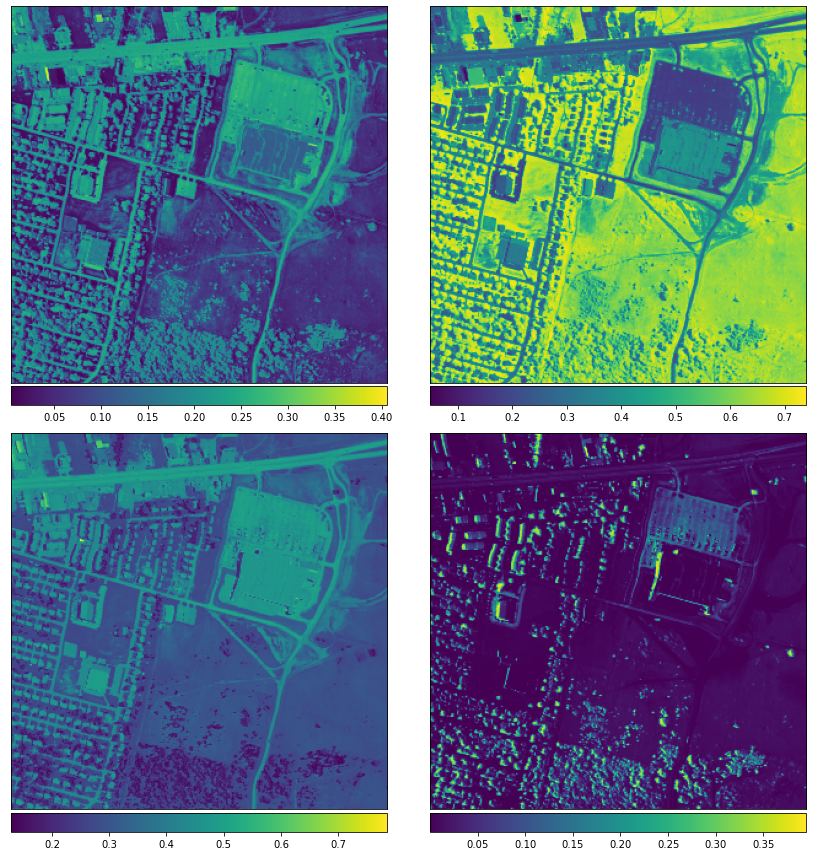

run nr: 11

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2811 - endmembers_loss: 1.5703 - endmembers_1_loss: 1.5702 - endmembers_2_loss: 1.5702 - endmembers_3_loss: 1.5704
Epoch 2/60
1/1 [==============================] - 0s 0s/step - loss: 6.2678 - endmembers_loss: 1.5666 - endmembers_1_loss: 1.5669 - endmembers_2_loss: 1.5673 - endmembers_3_loss: 1.5669
Epoch 3/60
1/1 [==============================] - 0s 0s/step - loss: 6.2681 - endmembers_loss: 1.5670 - endmembers_1_loss: 1.5672 - endmembers_2_loss: 1.5669 - endmembers_3_loss: 1.5670
Epoch 4/60
1/1 [==============================] - 0s 0s/step - loss: 6.2677 - endmembers_loss: 1.5667 - endmembers_1_loss: 1.5672 - endmembers_2_loss: 1.5667 - endmembers_3_loss: 1.5671
Epoch 5/60
1/1 [==============================] - 0s 16ms/step - loss: 6.2673 - endmembers_loss: 1.5665 - endmembers_1_loss: 1.5670 - endmembers_2_loss: 1.5670 - endmembers_3_loss: 1.5668
Epoch 6/60
1/1 [==============================] - 0s 0s/

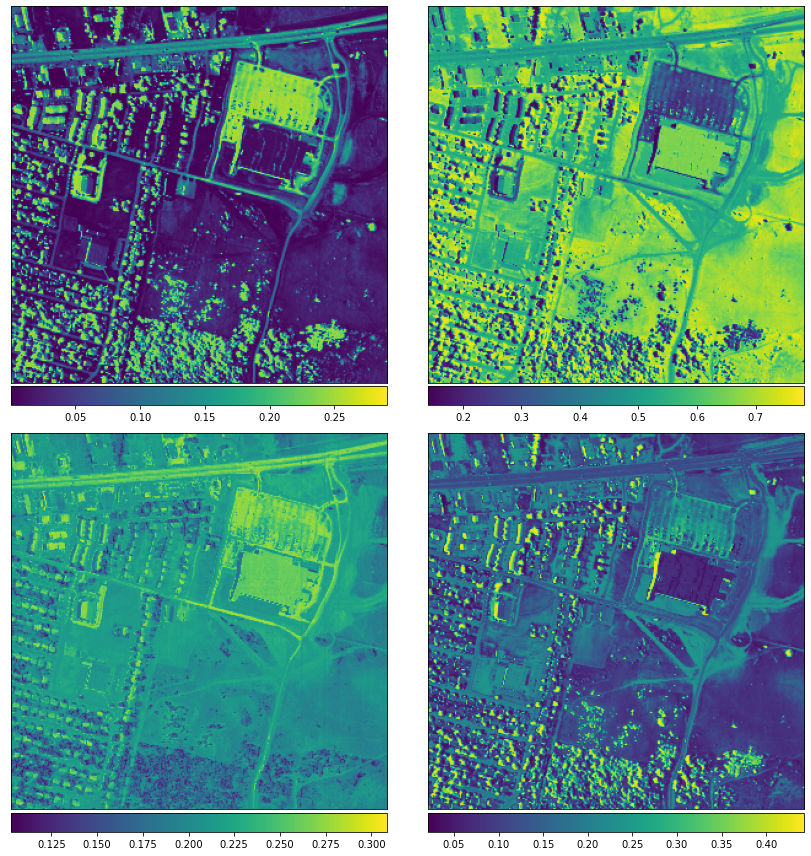

run nr: 12

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2812 - endmembers_loss: 1.5704 - endmembers_1_loss: 1.5701 - endmembers_2_loss: 1.5703 - endmembers_3_loss: 1.5703
Epoch 2/60
1/1 [==============================] - 0s 13ms/step - loss: 6.2691 - endmembers_loss: 1.5678 - endmembers_1_loss: 1.5676 - endmembers_2_loss: 1.5671 - endmembers_3_loss: 1.5666
Epoch 3/60
1/1 [==============================] - 0s 0s/step - loss: 6.2696 - endmembers_loss: 1.5676 - endmembers_1_loss: 1.5676 - endmembers_2_loss: 1.5674 - endmembers_3_loss: 1.5670
Epoch 4/60
1/1 [==============================] - 0s 16ms/step - loss: 6.2687 - endmembers_loss: 1.5672 - endmembers_1_loss: 1.5669 - endmembers_2_loss: 1.5672 - endmembers_3_loss: 1.5674
Epoch 5/60
1/1 [==============================] - 0s 0s/step - loss: 6.2685 - endmembers_loss: 1.5676 - endmembers_1_loss: 1.5673 - endmembers_2_loss: 1.5668 - endmembers_3_loss: 1.5667
Epoch 6/60
1/1 [==============================] - 0s 1

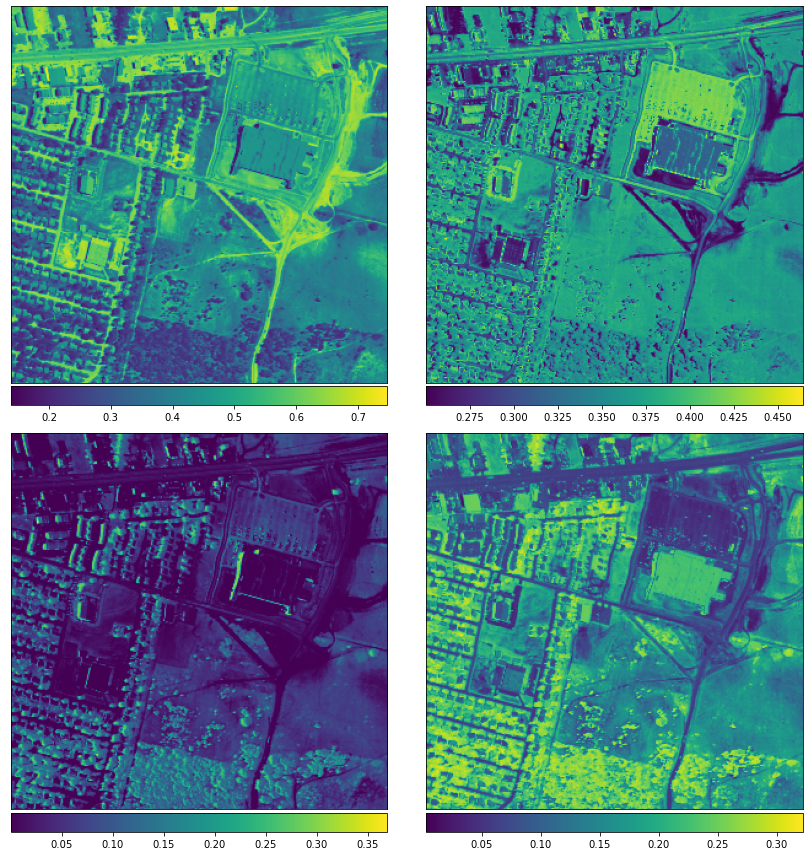

run nr: 13

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2800 - endmembers_loss: 1.5700 - endmembers_1_loss: 1.5701 - endmembers_2_loss: 1.5701 - endmembers_3_loss: 1.5699
Epoch 2/60
1/1 [==============================] - 0s 0s/step - loss: 6.2686 - endmembers_loss: 1.5671 - endmembers_1_loss: 1.5675 - endmembers_2_loss: 1.5669 - endmembers_3_loss: 1.5671
Epoch 3/60
1/1 [==============================] - 0s 0s/step - loss: 6.2685 - endmembers_loss: 1.5672 - endmembers_1_loss: 1.5670 - endmembers_2_loss: 1.5673 - endmembers_3_loss: 1.5670
Epoch 4/60
1/1 [==============================] - 0s 0s/step - loss: 6.2678 - endmembers_loss: 1.5669 - endmembers_1_loss: 1.5671 - endmembers_2_loss: 1.5667 - endmembers_3_loss: 1.5670
Epoch 5/60
1/1 [==============================] - 0s 0s/step - loss: 6.2672 - endmembers_loss: 1.5669 - endmembers_1_loss: 1.5668 - endmembers_2_loss: 1.5667 - endmembers_3_loss: 1.5668
Epoch 6/60
1/1 [==============================] - 0s 16ms/

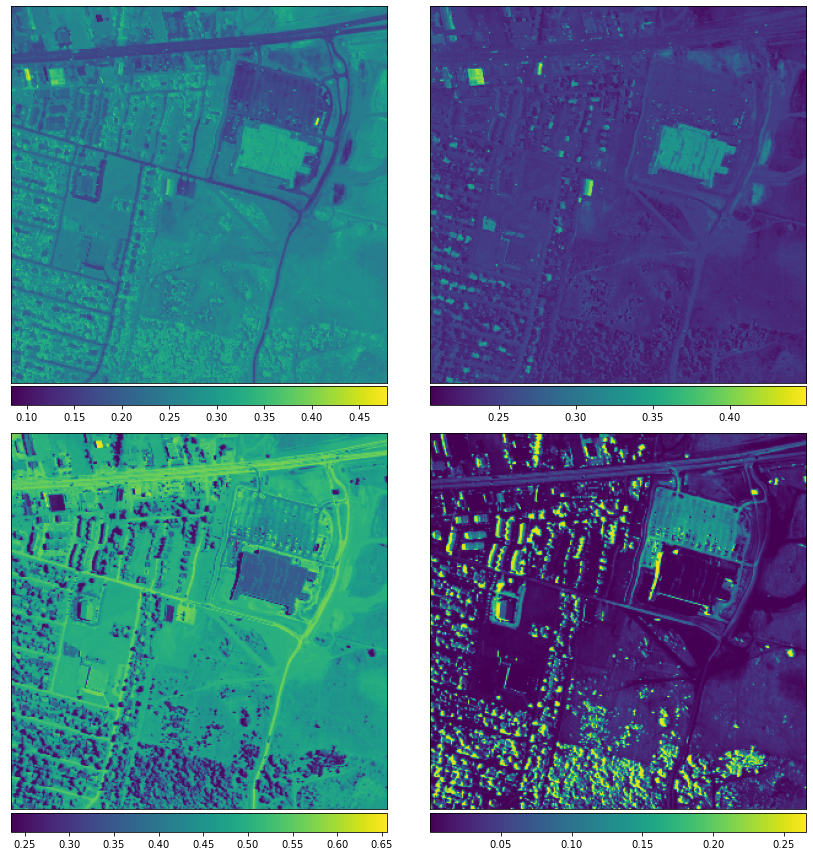

run nr: 14

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2801 - endmembers_loss: 1.5701 - endmembers_1_loss: 1.5702 - endmembers_2_loss: 1.5699 - endmembers_3_loss: 1.5699
Epoch 2/60
1/1 [==============================] - 0s 0s/step - loss: 6.2689 - endmembers_loss: 1.5674 - endmembers_1_loss: 1.5670 - endmembers_2_loss: 1.5675 - endmembers_3_loss: 1.5670
Epoch 3/60
1/1 [==============================] - 0s 16ms/step - loss: 6.2685 - endmembers_loss: 1.5672 - endmembers_1_loss: 1.5671 - endmembers_2_loss: 1.5670 - endmembers_3_loss: 1.5672
Epoch 4/60
1/1 [==============================] - 0s 0s/step - loss: 6.2687 - endmembers_loss: 1.5673 - endmembers_1_loss: 1.5673 - endmembers_2_loss: 1.5672 - endmembers_3_loss: 1.5670
Epoch 5/60
1/1 [==============================] - 0s 0s/step - loss: 6.2679 - endmembers_loss: 1.5670 - endmembers_1_loss: 1.5672 - endmembers_2_loss: 1.5669 - endmembers_3_loss: 1.5669
Epoch 6/60
1/1 [==============================] - 0s 16m

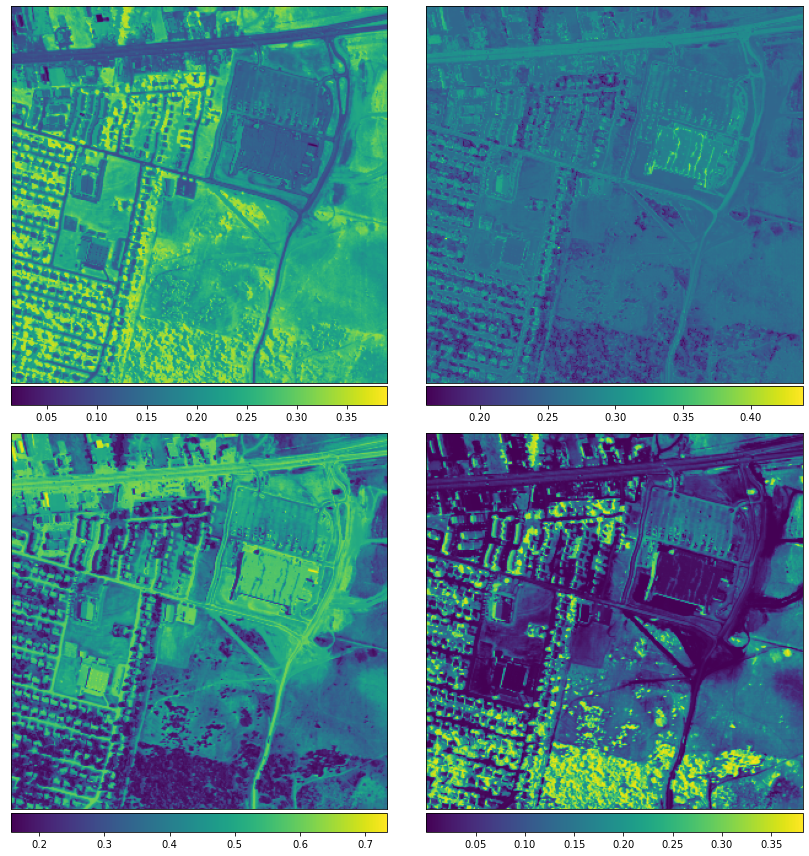

run nr: 15

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2812 - endmembers_loss: 1.5703 - endmembers_1_loss: 1.5703 - endmembers_2_loss: 1.5704 - endmembers_3_loss: 1.5702
Epoch 2/60
1/1 [==============================] - 0s 0s/step - loss: 6.2692 - endmembers_loss: 1.5670 - endmembers_1_loss: 1.5673 - endmembers_2_loss: 1.5674 - endmembers_3_loss: 1.5674
Epoch 3/60
1/1 [==============================] - 0s 15ms/step - loss: 6.2682 - endmembers_loss: 1.5670 - endmembers_1_loss: 1.5669 - endmembers_2_loss: 1.5669 - endmembers_3_loss: 1.5674
Epoch 4/60
1/1 [==============================] - 0s 0s/step - loss: 6.2688 - endmembers_loss: 1.5670 - endmembers_1_loss: 1.5671 - endmembers_2_loss: 1.5674 - endmembers_3_loss: 1.5673
Epoch 5/60
1/1 [==============================] - 0s 17ms/step - loss: 6.2682 - endmembers_loss: 1.5666 - endmembers_1_loss: 1.5672 - endmembers_2_loss: 1.5674 - endmembers_3_loss: 1.5670
Epoch 6/60
1/1 [==============================] - 0s 0

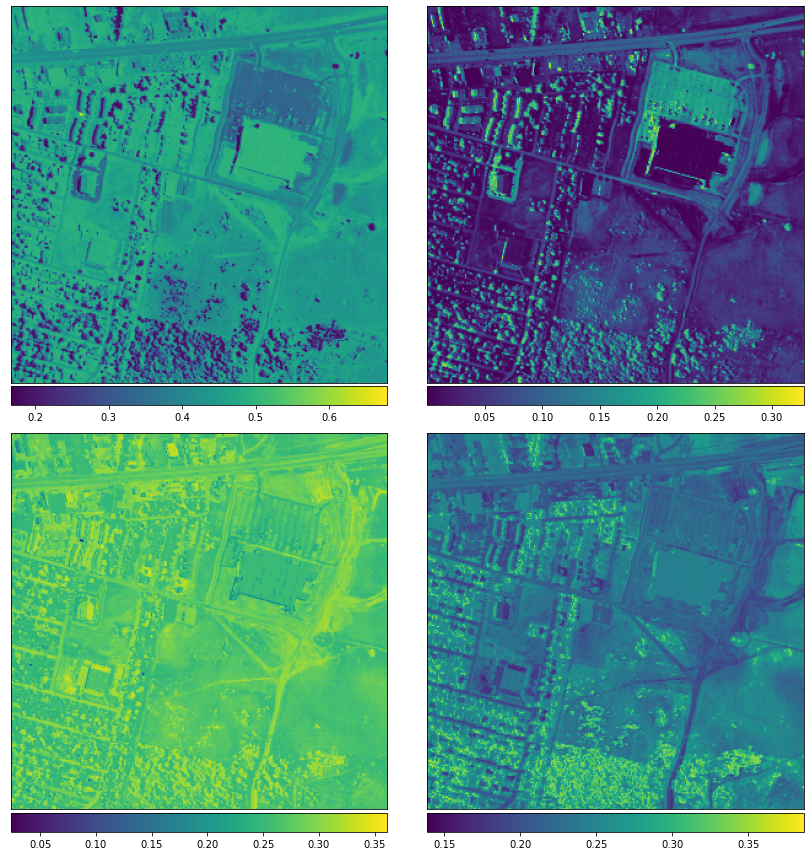

run nr: 16

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2815 - endmembers_loss: 1.5703 - endmembers_1_loss: 1.5704 - endmembers_2_loss: 1.5705 - endmembers_3_loss: 1.5703
Epoch 2/60
1/1 [==============================] - 0s 13ms/step - loss: 6.2676 - endmembers_loss: 1.5672 - endmembers_1_loss: 1.5663 - endmembers_2_loss: 1.5668 - endmembers_3_loss: 1.5674
Epoch 3/60
1/1 [==============================] - 0s 0s/step - loss: 6.2681 - endmembers_loss: 1.5671 - endmembers_1_loss: 1.5670 - endmembers_2_loss: 1.5671 - endmembers_3_loss: 1.5669
Epoch 4/60
1/1 [==============================] - 0s 16ms/step - loss: 6.2664 - endmembers_loss: 1.5667 - endmembers_1_loss: 1.5663 - endmembers_2_loss: 1.5664 - endmembers_3_loss: 1.5670
Epoch 5/60
1/1 [==============================] - 0s 0s/step - loss: 6.2664 - endmembers_loss: 1.5665 - endmembers_1_loss: 1.5665 - endmembers_2_loss: 1.5666 - endmembers_3_loss: 1.5669
Epoch 6/60
1/1 [==============================] - 0s 1

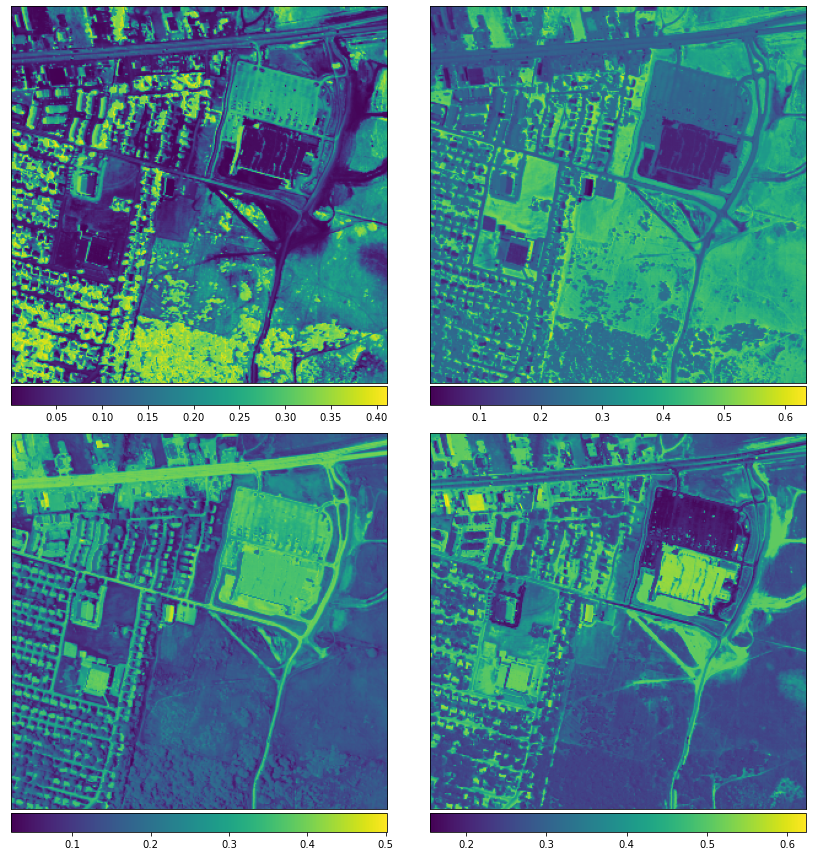

run nr: 17

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2800 - endmembers_loss: 1.5702 - endmembers_1_loss: 1.5700 - endmembers_2_loss: 1.5699 - endmembers_3_loss: 1.5698
Epoch 2/60
1/1 [==============================] - 0s 0s/step - loss: 6.2668 - endmembers_loss: 1.5670 - endmembers_1_loss: 1.5668 - endmembers_2_loss: 1.5663 - endmembers_3_loss: 1.5667
Epoch 3/60
1/1 [==============================] - 0s 0s/step - loss: 6.2672 - endmembers_loss: 1.5665 - endmembers_1_loss: 1.5669 - endmembers_2_loss: 1.5667 - endmembers_3_loss: 1.5670
Epoch 4/60
1/1 [==============================] - 0s 0s/step - loss: 6.2661 - endmembers_loss: 1.5665 - endmembers_1_loss: 1.5669 - endmembers_2_loss: 1.5663 - endmembers_3_loss: 1.5664
Epoch 5/60
1/1 [==============================] - 0s 0s/step - loss: 6.2655 - endmembers_loss: 1.5663 - endmembers_1_loss: 1.5669 - endmembers_2_loss: 1.5663 - endmembers_3_loss: 1.5661
Epoch 6/60
1/1 [==============================] - 0s 16ms/

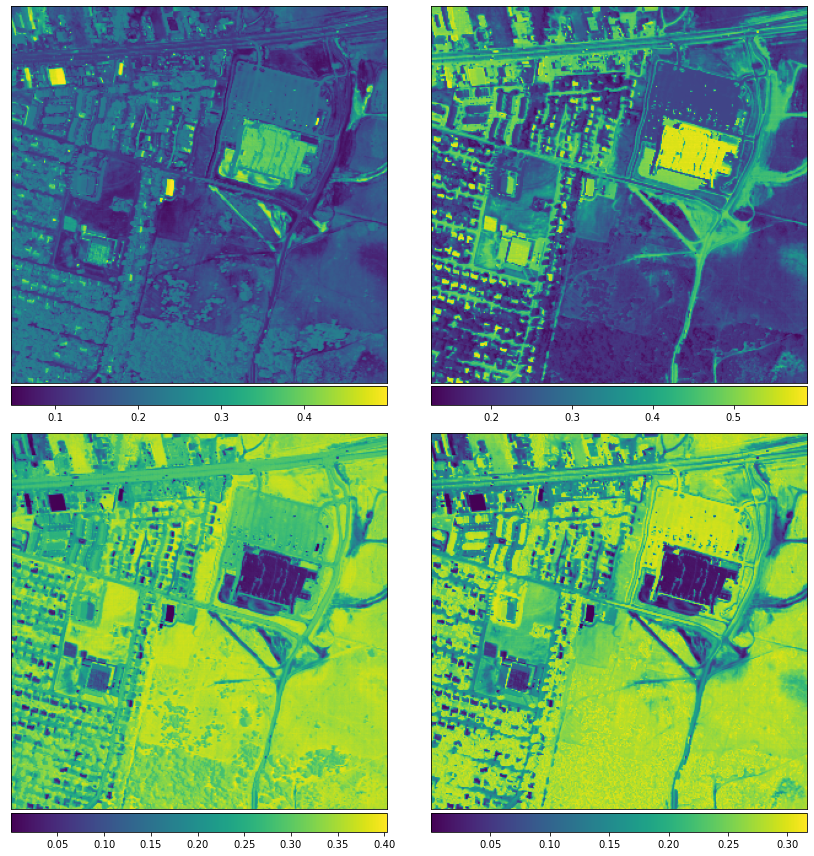

run nr: 18

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2800 - endmembers_loss: 1.5701 - endmembers_1_loss: 1.5697 - endmembers_2_loss: 1.5700 - endmembers_3_loss: 1.5702
Epoch 2/60
1/1 [==============================] - 0s 0s/step - loss: 6.2693 - endmembers_loss: 1.5669 - endmembers_1_loss: 1.5671 - endmembers_2_loss: 1.5679 - endmembers_3_loss: 1.5674
Epoch 3/60
1/1 [==============================] - 0s 0s/step - loss: 6.2683 - endmembers_loss: 1.5668 - endmembers_1_loss: 1.5672 - endmembers_2_loss: 1.5670 - endmembers_3_loss: 1.5673
Epoch 4/60
1/1 [==============================] - 0s 16ms/step - loss: 6.2688 - endmembers_loss: 1.5672 - endmembers_1_loss: 1.5673 - endmembers_2_loss: 1.5671 - endmembers_3_loss: 1.5672
Epoch 5/60
1/1 [==============================] - 0s 0s/step - loss: 6.2677 - endmembers_loss: 1.5664 - endmembers_1_loss: 1.5669 - endmembers_2_loss: 1.5675 - endmembers_3_loss: 1.5669
Epoch 6/60
1/1 [==============================] - 0s 0s/

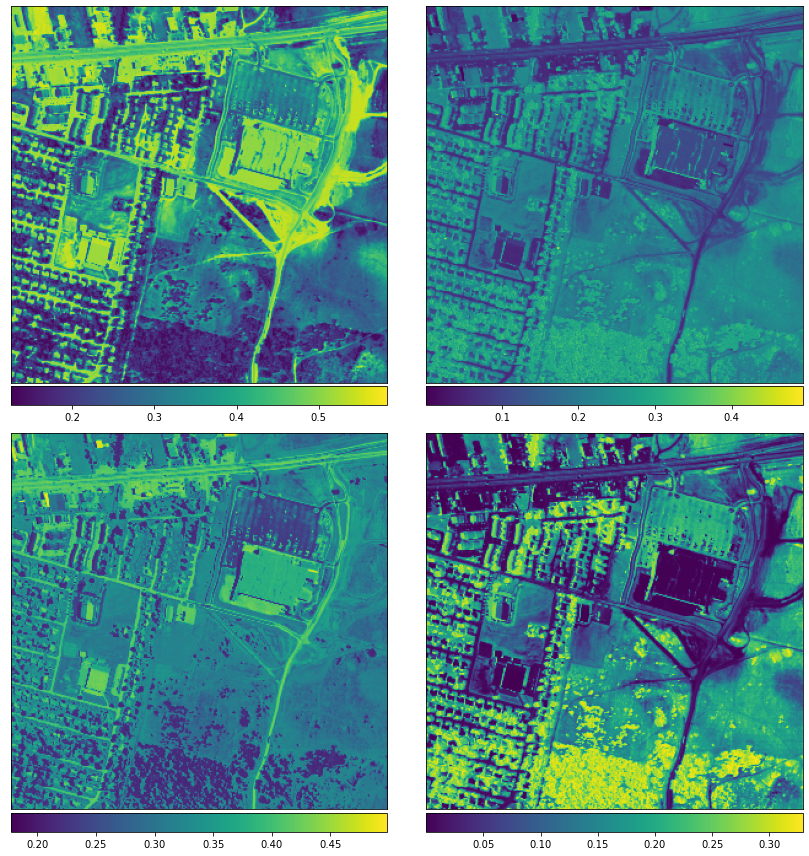

run nr: 19

Epoch 1/60
1/1 [==============================] - 2s 2s/step - loss: 6.2802 - endmembers_loss: 1.5702 - endmembers_1_loss: 1.5699 - endmembers_2_loss: 1.5701 - endmembers_3_loss: 1.5699
Epoch 2/60
1/1 [==============================] - 0s 0s/step - loss: 6.2690 - endmembers_loss: 1.5671 - endmembers_1_loss: 1.5675 - endmembers_2_loss: 1.5674 - endmembers_3_loss: 1.5670
Epoch 3/60
1/1 [==============================] - 0s 0s/step - loss: 6.2678 - endmembers_loss: 1.5672 - endmembers_1_loss: 1.5668 - endmembers_2_loss: 1.5668 - endmembers_3_loss: 1.5670
Epoch 4/60
1/1 [==============================] - 0s 16ms/step - loss: 6.2674 - endmembers_loss: 1.5669 - endmembers_1_loss: 1.5667 - endmembers_2_loss: 1.5671 - endmembers_3_loss: 1.5667
Epoch 5/60
1/1 [==============================] - 0s 0s/step - loss: 6.2678 - endmembers_loss: 1.5668 - endmembers_1_loss: 1.5671 - endmembers_2_loss: 1.5671 - endmembers_3_loss: 1.5668
Epoch 6/60
1/1 [==============================] - 0s 0s/

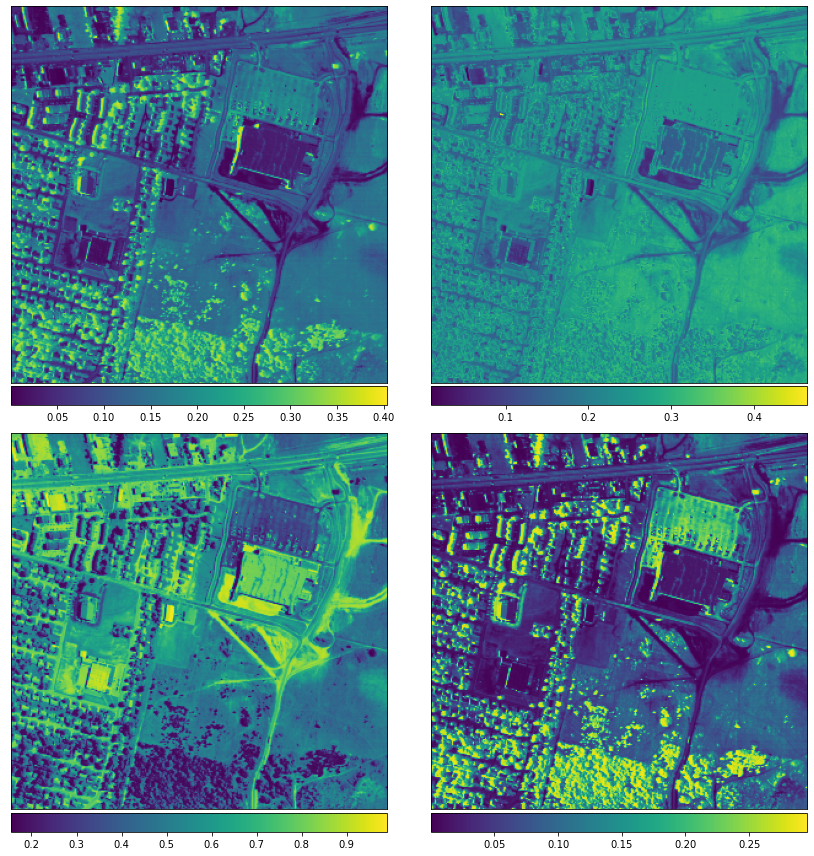

run nr: 20

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2795 - endmembers_loss: 1.5697 - endmembers_1_loss: 1.5698 - endmembers_2_loss: 1.5701 - endmembers_3_loss: 1.5699
Epoch 2/60
1/1 [==============================] - 0s 0s/step - loss: 6.2684 - endmembers_loss: 1.5672 - endmembers_1_loss: 1.5671 - endmembers_2_loss: 1.5667 - endmembers_3_loss: 1.5674
Epoch 3/60
1/1 [==============================] - 0s 16ms/step - loss: 6.2663 - endmembers_loss: 1.5663 - endmembers_1_loss: 1.5668 - endmembers_2_loss: 1.5668 - endmembers_3_loss: 1.5663
Epoch 4/60
1/1 [==============================] - 0s 0s/step - loss: 6.2662 - endmembers_loss: 1.5663 - endmembers_1_loss: 1.5665 - endmembers_2_loss: 1.5664 - endmembers_3_loss: 1.5670
Epoch 5/60
1/1 [==============================] - 0s 16ms/step - loss: 6.2658 - endmembers_loss: 1.5664 - endmembers_1_loss: 1.5664 - endmembers_2_loss: 1.5666 - endmembers_3_loss: 1.5664
Epoch 6/60
1/1 [==============================] - 0s 0

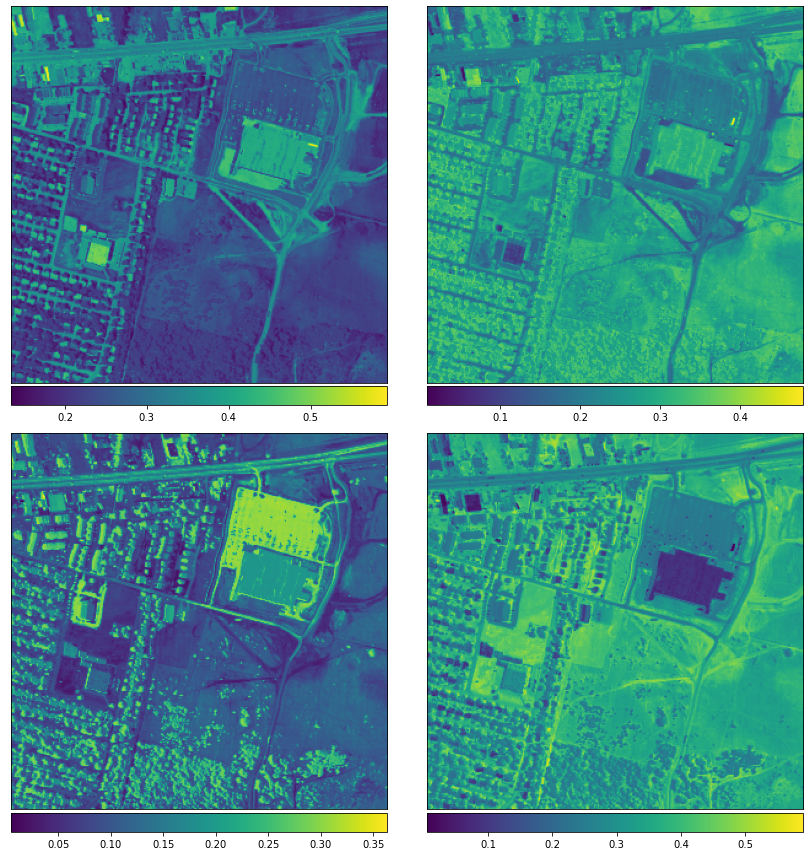

run nr: 21

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2809 - endmembers_loss: 1.5702 - endmembers_1_loss: 1.5705 - endmembers_2_loss: 1.5703 - endmembers_3_loss: 1.5699
Epoch 2/60
1/1 [==============================] - 0s 16ms/step - loss: 6.2689 - endmembers_loss: 1.5671 - endmembers_1_loss: 1.5673 - endmembers_2_loss: 1.5671 - endmembers_3_loss: 1.5674
Epoch 3/60
1/1 [==============================] - 0s 9ms/step - loss: 6.2687 - endmembers_loss: 1.5672 - endmembers_1_loss: 1.5670 - endmembers_2_loss: 1.5673 - endmembers_3_loss: 1.5672
Epoch 4/60
1/1 [==============================] - 0s 7ms/step - loss: 6.2682 - endmembers_loss: 1.5673 - endmembers_1_loss: 1.5669 - endmembers_2_loss: 1.5670 - endmembers_3_loss: 1.5670
Epoch 5/60
1/1 [==============================] - 0s 0s/step - loss: 6.2685 - endmembers_loss: 1.5668 - endmembers_1_loss: 1.5671 - endmembers_2_loss: 1.5674 - endmembers_3_loss: 1.5672
Epoch 6/60
1/1 [==============================] - 0s 1

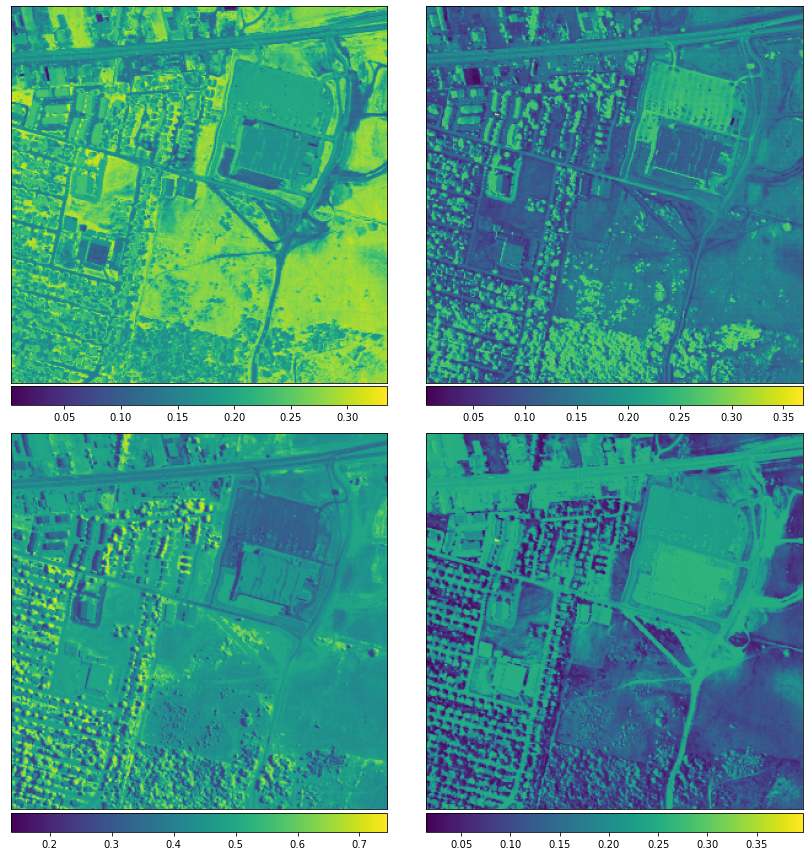

run nr: 22

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2812 - endmembers_loss: 1.5703 - endmembers_1_loss: 1.5704 - endmembers_2_loss: 1.5703 - endmembers_3_loss: 1.5703
Epoch 2/60
1/1 [==============================] - 0s 0s/step - loss: 6.2682 - endmembers_loss: 1.5666 - endmembers_1_loss: 1.5673 - endmembers_2_loss: 1.5669 - endmembers_3_loss: 1.5674
Epoch 3/60
1/1 [==============================] - 0s 0s/step - loss: 6.2682 - endmembers_loss: 1.5671 - endmembers_1_loss: 1.5670 - endmembers_2_loss: 1.5670 - endmembers_3_loss: 1.5671
Epoch 4/60
1/1 [==============================] - 0s 0s/step - loss: 6.2672 - endmembers_loss: 1.5668 - endmembers_1_loss: 1.5668 - endmembers_2_loss: 1.5668 - endmembers_3_loss: 1.5667
Epoch 5/60
1/1 [==============================] - 0s 0s/step - loss: 6.2671 - endmembers_loss: 1.5668 - endmembers_1_loss: 1.5667 - endmembers_2_loss: 1.5666 - endmembers_3_loss: 1.5669
Epoch 6/60
1/1 [==============================] - 0s 16ms/

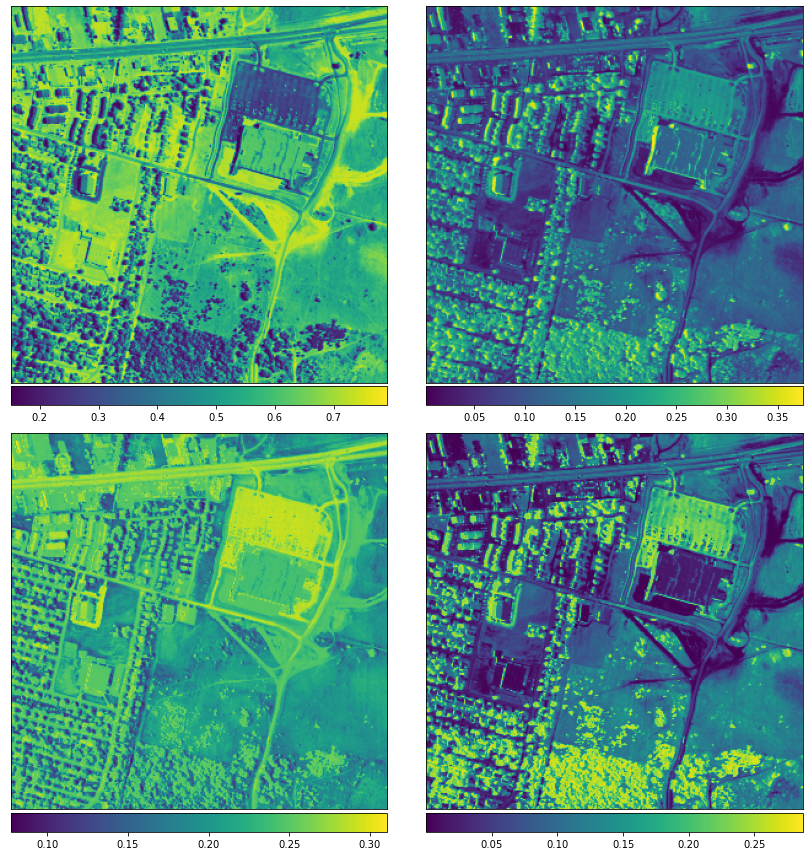

run nr: 23

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2809 - endmembers_loss: 1.5703 - endmembers_1_loss: 1.5703 - endmembers_2_loss: 1.5702 - endmembers_3_loss: 1.5702
Epoch 2/60
1/1 [==============================] - 0s 0s/step - loss: 6.2693 - endmembers_loss: 1.5674 - endmembers_1_loss: 1.5675 - endmembers_2_loss: 1.5670 - endmembers_3_loss: 1.5674
Epoch 3/60
1/1 [==============================] - 0s 16ms/step - loss: 6.2673 - endmembers_loss: 1.5673 - endmembers_1_loss: 1.5670 - endmembers_2_loss: 1.5667 - endmembers_3_loss: 1.5664
Epoch 4/60
1/1 [==============================] - 0s 6ms/step - loss: 6.2670 - endmembers_loss: 1.5666 - endmembers_1_loss: 1.5668 - endmembers_2_loss: 1.5669 - endmembers_3_loss: 1.5667
Epoch 5/60
1/1 [==============================] - 0s 11ms/step - loss: 6.2677 - endmembers_loss: 1.5670 - endmembers_1_loss: 1.5669 - endmembers_2_loss: 1.5670 - endmembers_3_loss: 1.5668
Epoch 6/60
1/1 [==============================] - 0s 

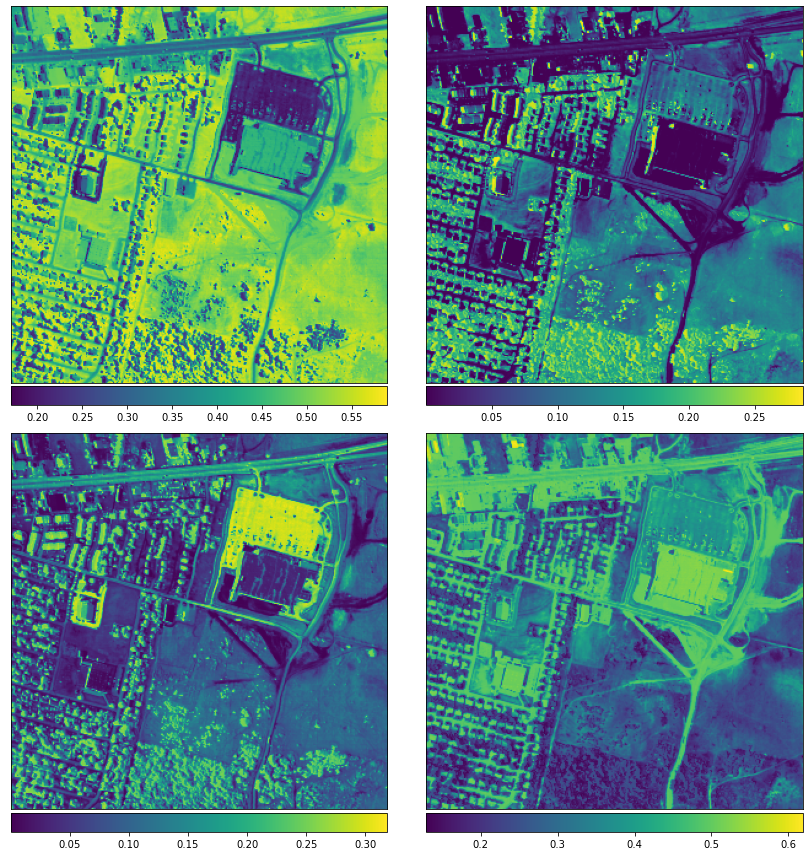

run nr: 24

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2811 - endmembers_loss: 1.5703 - endmembers_1_loss: 1.5703 - endmembers_2_loss: 1.5703 - endmembers_3_loss: 1.5702
Epoch 2/60
1/1 [==============================] - 0s 0s/step - loss: 6.2691 - endmembers_loss: 1.5672 - endmembers_1_loss: 1.5672 - endmembers_2_loss: 1.5673 - endmembers_3_loss: 1.5674
Epoch 3/60
1/1 [==============================] - 0s 0s/step - loss: 6.2690 - endmembers_loss: 1.5672 - endmembers_1_loss: 1.5676 - endmembers_2_loss: 1.5671 - endmembers_3_loss: 1.5672
Epoch 4/60
1/1 [==============================] - 0s 16ms/step - loss: 6.2684 - endmembers_loss: 1.5669 - endmembers_1_loss: 1.5671 - endmembers_2_loss: 1.5674 - endmembers_3_loss: 1.5670
Epoch 5/60
1/1 [==============================] - 0s 0s/step - loss: 6.2680 - endmembers_loss: 1.5669 - endmembers_1_loss: 1.5667 - endmembers_2_loss: 1.5675 - endmembers_3_loss: 1.5668
Epoch 6/60
1/1 [==============================] - 0s 16m

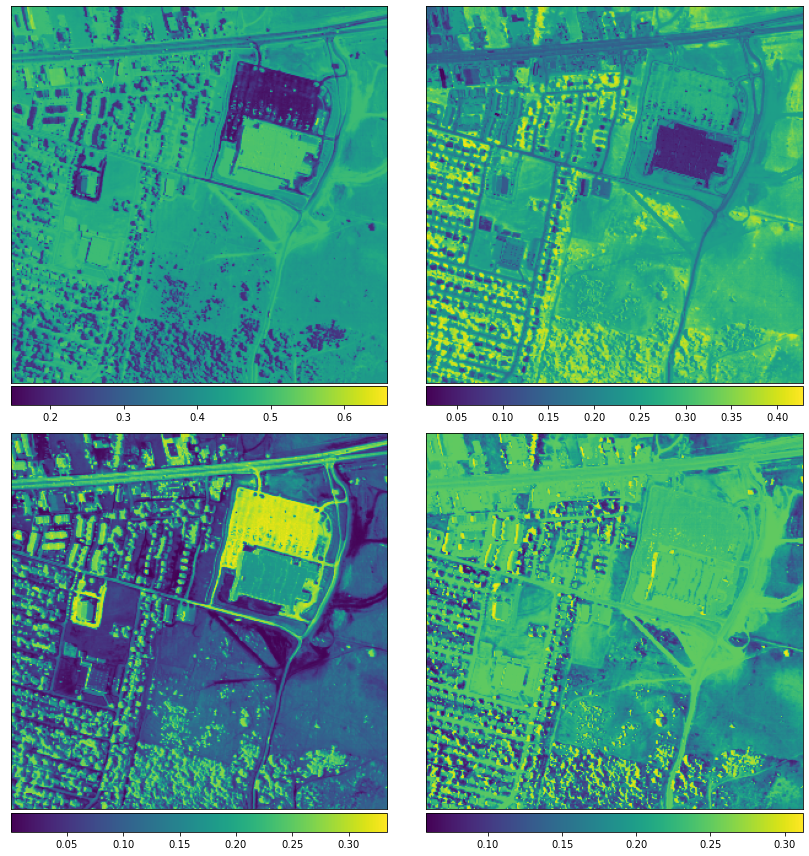

run nr: 25

Epoch 1/60
1/1 [==============================] - 3s 3s/step - loss: 6.2808 - endmembers_loss: 1.5702 - endmembers_1_loss: 1.5702 - endmembers_2_loss: 1.5703 - endmembers_3_loss: 1.5702
Epoch 2/60
1/1 [==============================] - 0s 16ms/step - loss: 6.2695 - endmembers_loss: 1.5676 - endmembers_1_loss: 1.5676 - endmembers_2_loss: 1.5674 - endmembers_3_loss: 1.5669
Epoch 3/60
1/1 [==============================] - 0s 8ms/step - loss: 6.2684 - endmembers_loss: 1.5675 - endmembers_1_loss: 1.5672 - endmembers_2_loss: 1.5666 - endmembers_3_loss: 1.5671
Epoch 4/60
1/1 [==============================] - 0s 8ms/step - loss: 6.2680 - endmembers_loss: 1.5674 - endmembers_1_loss: 1.5671 - endmembers_2_loss: 1.5671 - endmembers_3_loss: 1.5664
Epoch 5/60
1/1 [==============================] - 0s 0s/step - loss: 6.2679 - endmembers_loss: 1.5669 - endmembers_1_loss: 1.5670 - endmembers_2_loss: 1.5671 - endmembers_3_loss: 1.5669
Epoch 6/60
1/1 [==============================] - 0s 0

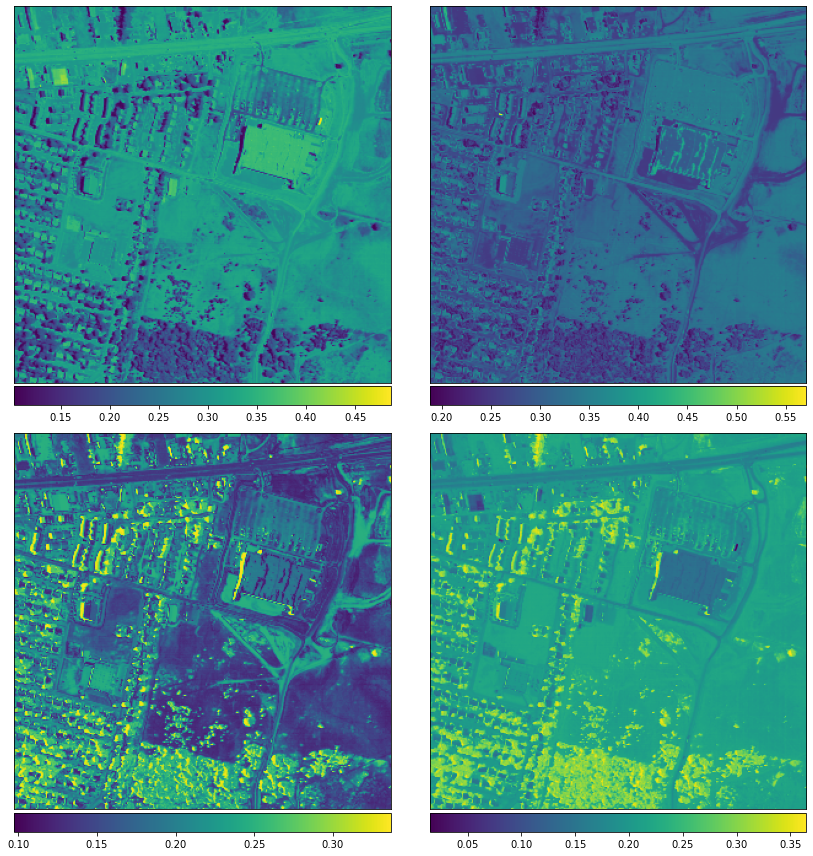

In [24]:
num_runs = 25
results_folder = './Results4'
method_name = 'MTAEU'

for dataset in ['Urban']:
    save_folder = results_folder+'/'+method_name+'/'+dataset
    if not os.path.exists(save_folder):
        os.makedirs(save_folder)
    hsi = load_HSI( datasetnames[dataset] + ".mat")

    for run in range(1,num_runs+1):
        print('run nr: '+str(run)+'\n')
        params = {
        'n_inputs':n_inputs,
        "activation": activation,
        "num_endmembers": num_endmembers,
        "batch_size": batch_size,
        "num_spectra": 3,
        "data": hsi,
        "epochs": epochs,
        "n_bands": hsi.bands,
        #"GT": hsi.gt,
        "lr": learning_rate,
        "optimizer": tf.optimizers.RMSprop(learning_rate=learning_rate,decay=0.0001),
        "loss": loss,
        "scale": 3,
        "l1": l1,
        }
        training_data = make_patches(hsi,params['n_inputs'],params['num_spectra'])
        save_folder = results_folder+'/'+method_name+'/'+dataset
        save_name = dataset+'_run'+str(run)+'.mat'
        save_path = save_folder+'/'+save_name
        autoencoder = Autoencoder(params)
        autoencoder.fit(training_data)
        endmembers = autoencoder.get_endmembers()
        abundances = autoencoder.get_abundances()
        #plotEndmembersAndGT(endmembers, hsi.gt)
        plotAbundancesSimple(abundances,'abund.png')
        sio.savemat(save_path,{'M':endmembers,'A':abundances})
        del autoencoder
    